 * <h1>230818 프로젝트_shinjihye</h1>

1. 서울시 쏘카존 데이터를 활용한 시각화
2. 서울시 카페와 버스 정류장 밀도 데이터를 이용한 시각화
3. 2번의 시각화 자료에 쏘카존 데이터 추가해 표현하기

In [84]:
import json
import os
import pandas as pd
import geopandas as gpd
import folium
from folium import plugins
from folium.plugins import MarkerCluster, HeatMap

import requests
import math
import time
import numpy as np
import geopandas as gpd
import matplotlib.pyplot as plt

from shapely.geometry import mapping, shape, Point, Polygon, LineString
from folium import plugins
from folium.plugins import MarkerCluster, HeatMap

# print(pd.__version__)
# print(gpd.__version__)
# print(folium.__version__)

* 공간 데이터를 활용한 시각화 방법

1. csv/API 등을 이용해 DataFrame으로 만들기 위한 전처리
2. DataFrame 생성 후 데이터 전처리
3. 위도 경도 데이터 타입 확인
4. 좌표계 확인(WSG84)
5. Folium을 이용해 시각화

> <h3> 11-1. 서울시 쏘카존 데이터를 활용한 시각화</h3>
- 먼저 쏘카존 정보가 담긴 CSV 파일을 DataFrame으로 읽어옵니다.

In [85]:
path = '/aiffel/aiffel/socar_gis/data/20210823_socar_zone.csv'

socar_zone_info_df = pd.read_csv(path)
socar_zone_info_df.head()
socar_zone_info_df.tail()

,zone_name,lng,lat,region1,region2,region3
4323,서울숲역 5번출구(D타워),127.044386,37.544701,서울특별시,성동구,성수동1가
4324,홍대입구역 교차로,126.920696,37.555192,서울특별시,마포구,서교동
4325,서대전역 앞(KTX),127.404434,36.322323,대전광역시,중구,오류동
4326,롯데백화점 울산점 옆,129.340630,35.537504,울산광역시,남구,삼산동
4327,울산대 정문,129.260590,35.542278,울산광역시,남구,무거동


- Folium 초기 Map 객체를 생성 합니다. 
- 초기 Map 메소드에는 초기 중심값 좌표가 들어가야 합니다. 
- map의 위치는 center에 위치하고, zoom 레벨은 12로 시작합니다.

In [86]:
# 서울시 중심부 위도, 경도
import folium
center = [37.541, 126.986]

map = folium.Map(
    location=center,
    zoom_start=12
)

print('슝~')

슝~


1. 마커들을 그룹화해주는 MarkerCluster 객체를 만들고, <br>
2. 쏘카존 이름, 위도, 경도를 가져와 Marker 객체로 추가해 줍니다.<br>

* zone_name, lat(위도), lng(경도) 

In [87]:
# MarkerCluster 객체 만들기
marker_cluster = MarkerCluster().add_to(map)

In [88]:
#maker 객체 추가
for _, row in socar_zone_info_df.iterrows():           # 행 하나씩 들고오는 것 
# for index_num in range(len(socar_zone_info_df)):
    try:
        folium.Marker(
            # 좌표 (쏘카존 이름, 위도, 경도 추가)
            location=[row["lat"], row["lng"]],
            # 클릭시 표시될 popup 내용
            popup=row["zone_name"],
            icon=folium.Icon(color="cadetblue", icon="car", prefix="fa")
        ).add_to(marker_cluster)
    except:
            pass

print('슝~')

슝~


In [89]:
map

<h3> 11-2. 프로젝트(2) 서울시 카페와 버스 정류장 밀도 데이터를 이용한 시각화</h3>

>2번째 프로젝트는 서울시 카페 밀도 데이터와 버스 정류장 밀도 데이터를 이용한 시각화입니다.

In [14]:
temp_seoul_store_df = pd.read_csv('/aiffel/aiffel/socar_gis/data/seoul_store_info_202106.csv')
temp_seoul_store_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 316078 entries, 0 to 316077
Data columns (total 39 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   상가업소번호     316078 non-null  int64  
 1   상호명        316077 non-null  object 
 2   지점명        54615 non-null   object 
 3   상권업종대분류코드  316078 non-null  object 
 4   상권업종대분류명   316078 non-null  object 
 5   상권업종중분류코드  316078 non-null  object 
 6   상권업종중분류명   316078 non-null  object 
 7   상권업종소분류코드  316078 non-null  object 
 8   상권업종소분류명   316078 non-null  object 
 9   표준산업분류코드   286026 non-null  object 
 10  표준산업분류명    286026 non-null  object 
 11  시도코드       316078 non-null  int64  
 12  시도명        316078 non-null  object 
 13  시군구코드      316078 non-null  int64  
 14  시군구명       316078 non-null  object 
 15  행정동코드      316078 non-null  int64  
 16  행정동명       315898 non-null  object 
 17  법정동코드      316078 non-null  int64  
 18  법정동명       316078 non-null  object 
 19  지번코드       316078 non-n

- 우리는 카페 정보를 알고 싶기 때문에 데이터 프레임에서 상권업종소분류코드 컬럼에서 'Q12A01'만 필터링합니다. 
- 참고로 Q12A01는 커피점/카페 분류코드입니다. 

In [90]:
seoul_cafe_store_df = temp_seoul_store_df[temp_seoul_store_df["상권업종소분류코드"] == "Q12A01"]
seoul_cafe_store_df.head()

,상가업소번호,상호명,지점명,상권업종대분류코드,상권업종대분류명,상권업종중분류코드,상권업종중분류명,상권업종소분류코드,상권업종소분류명,표준산업분류코드,...,건물관리번호,건물명,도로명주소,구우편번호,신우편번호,동정보,층정보,호정보,경도,위도
28,20659878,커피빈,코리아대학로대명거리점,Q,음식,Q12,커피점/카페,Q12A01,커피전문점/카페/다방,I56220,...,1111017200100510000032165,NaN,서울특별시 종로구 대명길 25,110524,3078.0,NaN,3,NaN,127.000171,37.583149
111,20676428,요거프레소,쌍문점,Q,음식,Q12,커피점/카페,Q12A01,커피전문점/카페/다방,I56220,...,1132010500100200000006625,NaN,서울특별시 도봉구 도당로 7,132030,1385.0,NaN,1,NaN,127.034746,37.658728
190,20695531,메머드커피,NaN,Q,음식,Q12,커피점/카페,Q12A01,커피전문점/카페/다방,I56220,...,1144012000103270015009846,NaN,서울특별시 마포구 와우산로 149,121836,4052.0,NaN,1,NaN,126.929692,37.554599
197,28491095,우성커피숍,NaN,Q,음식,Q12,커피점/카페,Q12A01,커피전문점/카페/다방,I56220,...,1147010300105140002010707,NaN,서울특별시 양천구 오목로 48,158090,8029.0,NaN,1,NaN,126.842935,37.522055
225,20815616,카페클럽,NaN,Q,음식,Q12,커피점/카페,Q12A01,커피전문점/카페/다방,I56220,...,1171010800100430006004404,NaN,서울특별시 송파구 동남로2길 3-6,138200,5805.0,NaN,1,NaN,127.122480,37.488907


In [91]:
# 위도와 경도가 float이어야 함 
seoul_cafe_store_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 20481 entries, 28 to 315945
Data columns (total 39 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   상가업소번호     20481 non-null  int64  
 1   상호명        20481 non-null  object 
 2   지점명        7320 non-null   object 
 3   상권업종대분류코드  20481 non-null  object 
 4   상권업종대분류명   20481 non-null  object 
 5   상권업종중분류코드  20481 non-null  object 
 6   상권업종중분류명   20481 non-null  object 
 7   상권업종소분류코드  20481 non-null  object 
 8   상권업종소분류명   20481 non-null  object 
 9   표준산업분류코드   19124 non-null  object 
 10  표준산업분류명    19124 non-null  object 
 11  시도코드       20481 non-null  int64  
 12  시도명        20481 non-null  object 
 13  시군구코드      20481 non-null  int64  
 14  시군구명       20481 non-null  object 
 15  행정동코드      20481 non-null  int64  
 16  행정동명       20478 non-null  object 
 17  법정동코드      20481 non-null  int64  
 18  법정동명       20481 non-null  object 
 19  지번코드       20481 non-null  int64  
 20  대지구분

In [92]:
# * 카페 밀도를 표현하기 위해 위치데이터 리스트를 생성합니다.
seoul_cafe_location_data = [[row["위도"], row["경도"]] for _, row in seoul_cafe_store_df.iterrows()]
print("슝~")

슝~


In [93]:
# 이제 서울시 버스 정류장 밀도 데이터 리스트를 생성합니다.
# 서울공공데이터 홈페이지에서 다운로드 받은 버스노선 정보 csv 파일을 DataFrame으로 읽어옵니다.

In [94]:
path ='/aiffel/aiffel/socar_gis/data/seoul_bus_line_info.csv'
bus_line_info_df = pd.read_csv(path)
bus_line_info_df.head()

,노선ID,노선명,순번,구간ID,정류소ID,ARS-ID,정류소명,X좌표,Y좌표
0,100100124,0017,1,0,102000271,3689,청암자이아파트,126.946517,37.534363
1,100100124,0017,2,102700549,102000204,3298,청암동강변삼성아파트,126.949304,37.533961
2,100100124,0017,3,102700550,102000227,3321,청심경로당,126.950449,37.533744
3,100100124,0017,4,102700551,102000210,3304,원효2동주민센터,126.950904,37.534278
4,100100124,0017,5,102700552,102000212,3306,산천동,126.953984,37.535420


In [95]:
# 컬럼명 변경 (경도와 위도로 변경)
bus_line_info_df.rename(
    columns={
        "Y좌표": "lat",
        "X좌표": "lng",
    },
    inplace=True
)

bus_line_info_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39363 entries, 0 to 39362
Data columns (total 9 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   노선ID    39363 non-null  int64  
 1   노선명     39363 non-null  object 
 2   순번      39363 non-null  int64  
 3   구간ID    39363 non-null  int64  
 4   정류소ID   39363 non-null  int64  
 5   ARS-ID  39363 non-null  int64  
 6   정류소명    39363 non-null  object 
 7   lng     39363 non-null  float64
 8   lat     39363 non-null  float64
dtypes: float64(2), int64(5), object(2)
memory usage: 2.7+ MB


In [96]:
bus_line_info_df.head()

,노선ID,노선명,순번,구간ID,정류소ID,ARS-ID,정류소명,lng,lat
0,100100124,0017,1,0,102000271,3689,청암자이아파트,126.946517,37.534363
1,100100124,0017,2,102700549,102000204,3298,청암동강변삼성아파트,126.949304,37.533961
2,100100124,0017,3,102700550,102000227,3321,청심경로당,126.950449,37.533744
3,100100124,0017,4,102700551,102000210,3304,원효2동주민센터,126.950904,37.534278
4,100100124,0017,5,102700552,102000212,3306,산천동,126.953984,37.535420


In [97]:
# 버스 정류장 밀도를 표현해주기 위한 위치데이터 리스트 만들기 (lat = 위도/ lng = 경도)
# bus_station_location_data = bus_line_info_df[["lat","lng"]].values.tolist()

bus_station_location_data = [[row["lat"], row["lng"]] for _, row in bus_line_info_df.iterrows()]

<h4> Heatmap 형태로 시각화하기</h4>
1. Folium 초기 Map 객체를 생성합니다. 초기 Map 메소드에는 초기 중심값 좌표가 들어가야 합니다.<br>
2. tiles 파라미터를 "Stamen Terrain"로 바꿔줍니다.<br>
3. zoom_start를 15로 설정합니다.

In [98]:
# Folium 초기 Map 객체 생성 

# 서울시 중심부 위도, 경도
center = [37.541, 126.986]

map = folium.Map(
    location=center,
    tiles="Stamen Terrain",
    zoom_start=15 
)
print('슝~')

슝~


이제 Folium의 plugins 메소드를 이용해 다양한 인자를 하나의 Map에 시각화해 봅니다. <br>
우선 레이어 적용을 위해 그룹을 만들고, 레이어 콘트롤 박스를 만듭니다.

In [99]:
# 레이어 적용을 위한 그룹 만들기
# 대표 그룹 만들기
fg = folium.FeatureGroup(name="groups")
map.add_child(fg)

# 카페 그룹 만들기
cafe = plugins.FeatureGroupSubGroup(fg, "cafe_density")
map.add_child(cafe)

# 버스정류장 그룹 만들기
bus_station = plugins.FeatureGroupSubGroup(fg,"bus_station")
map.add_child(bus_station)

# 레이어 콘트롤 박스 만들기
folium.LayerControl(collapsed=False).add_to(map)

In [100]:
# 카페와 버스 정류장의 밀도를 Heatmap에 추가한 후 시각화합니다.

# 카페 밀도
plugins.HeatMap(seoul_cafe_location_data).add_to(cafe)
# 버스정류장 밀도
plugins.HeatMap(bus_station_location_data).add_to(bus_station)

In [28]:
map

<h3>11-3. 프로젝트(3) 시각화 자료에 쏘카존 데이터 추가하기</h3> <br>
프로젝트 (1)에서 진행한 쏘카존 데이터를 프로젝트 (2)에서 진행한 시각화 자료에 추가해보겠습니다.

<h4>쏘카존 데이터를 시각화 자료에 추가하기</h4>
쏘카존 데이터를 프로젝트 (2)의 시각화 자료에 추가하는 방법은 아래와 같습니다.

1. Folium 사용을 위해 초기 맵 생성(프로젝트 (2) 참고)
2. Heatmap 형식으로 생성할 레이어 적용을 위한 그룹만들기
3. 쏘카존 마커 클러스터 만들기
4. 카페 그룹, 버스 정류장 그룹, 쏘카존 그룹, 레이어 컨트롤 박스 만들기
5. 카페 밀도 맵에 추가하기
6. 버스 정류장 밀도 맵에 추가하기
7. 쏘카존 마커 맵에 추가하기(프로젝트 (1) 참고)
8. 생성한 맵 확인

In [101]:
# 1. Folium 사용을 위해 초기 맵 생성(프로젝트 (2) 참고)
# 초기 Map 메소드에는 초기 중심값 좌표가 들어가야 합니다.

center = [37.541, 126.986]                             # 서울시 중심부 위도, 경도

map = folium.Map(
    location=center,
    tiles= "Stamen Terrain",
    zoom_start=15 
)

print("슝~")

슝~


<h4>2. Heatmap 형식으로 생성할 레이어 적용을 위한 그룹만들기</h4>

In [102]:
# 레이어 적용을 위한 대표 그룹 만들기
fg = folium.FeatureGroup(name="groups")
map.add_child(fg)

<h4>3. 카페 그룹, 버스 정류장 그룹, 쏘카존 그룹, 레이어 컨트롤 박스 만들기</h4>

In [103]:
# fg는 그룹이름 

# 카페 그룹 만들기
cafe = plugins.FeatureGroupSubGroup(fg, "cafe_density")
map.add_child(cafe)

# 버스정류장 그룹 만들기
bus_station = plugins.FeatureGroupSubGroup(fg,"bus_station")
map.add_child(bus_station)

# 쏘카존 그룹 만들기
socar_zone = plugins.FeatureGroupSubGroup(fg,"socar_zone")
map.add_child(socar_zone)

# 레이어 콘트롤 박스 만들기
folium.LayerControl(collapsed=False).add_to(map)

<h4>4. 카페 밀도 맵에 추가하기</h4>

In [104]:
# 카페 밀도
plugins.HeatMap(seoul_cafe_location_data).add_to(cafe)

<h4>5. 버스 정류장 밀도 맵에 추가하기</h4>

In [105]:
# 버스정류장 밀도
plugins.HeatMap(bus_station_location_data).add_to(bus_station)

<h4> 6. 쏘카존 마커 맵에 추가하기(프로젝트 (1) 참고) </h4>

In [106]:
# 쏘카존 마커클러스터 만들기 (저 그룹안에 마커클러스터를 집어넣음)
marker_cluster = MarkerCluster().add_to(socar_zone)

# 쏘카존 마커, maker 객체 추가 (mg에 찍어줘야함/ 클러스트 만들었던)
for _, row in socar_zone_info_df.iterrows():              # 행 하나씩 들고오는 것 
    try:
        folium.Marker(
            # 좌표 (쏘카존 위도, 경도 추가)
            location=[row["lat"], row["lng"]],
            # 클릭시 표시될 popup 내용
            popup=row["zone_name"],
            icon=folium.Icon(color="cadetblue", icon="car", prefix="fa")
        ).add_to(marker_cluster)
    except:
            pass

In [107]:
map

<h2> Q. 여러분이 쏘카존 담당이라고 할 때 완성된 시각화 자료를 토대로 현존 쏘카존에 대한 타당성 평가를 진행하고
신규 쏘카존 선정 및 선정 이유를 설명하시오.</h2> 

<h3>답변</h3> 

***
1. 현존 쏘카존에 대한 타당성 평가
대체로 수도권인 서울쪽은 인구밀도 대비 적절하게 쏘카존이 잘 분포되어있다고 생각합니다 (대부분 빨간편) 
또한 대중교통인 버스정류장 간의 접근성도 따져보았을 때 적절한 위치에 잘 있다고 판단됩니다. 
***

2. 신규 쏘카존 선정 이유
- 석촌호수 근처 & 송파나루역 & 방이동에 밀집해있는 상권과 인구 수에 비해 (카페, 버스정류장 등을 보고 판단) 분포되어있는 쏘카존이 2개 밖에 없어 조금 부족하다고 생각되어 신규 쏘카존을 선정하게 되었습니다. 

- 잠실 부근에 놀러갔다가 올림픽대로 혹은 잠실대교를 따라 근교 서울 드라이브 혹은 경기권 아울렛까지 놀러 가는 경우가 많은 것으로 알고있는데 이러한 상황들을 고려하면 수요에 비해 쏘카존이 부족하다고 생각합니다. 

- 송파나루역 부근은 송리단길이라고도 불리며 다양한 카페, 밥집, 술집, 미용실등이 줄지어 있습니다. <br> 쏘카존을 추가로 선정한다면 쏘카 이용률을 높일 수 있을 것이라는 생각이 듭니다 :) 

**송리단길 부근**  => ♡ 하트로 표시함 

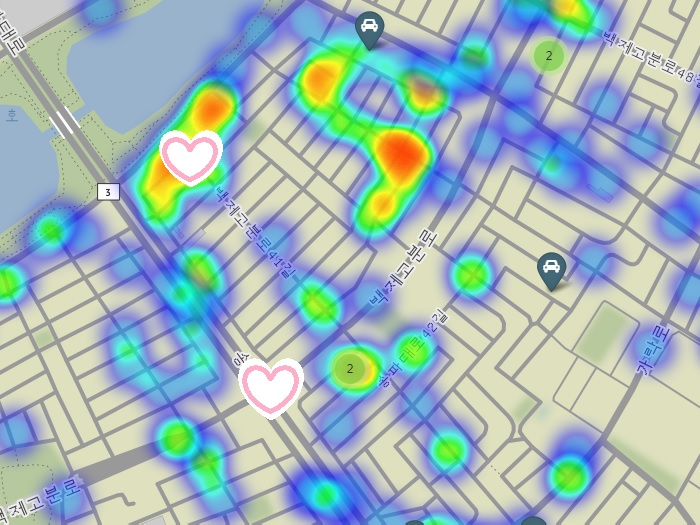




> <h3>회고록</h3> 

<h4> 이번 프로젝트를 진행하면서 어려웠던 점</h4>

> 짧은 시간 내 folium 라이브러리를 활용하여 마커, 클러스터, 히트맵을 한번에 모두 사용하여 문제를 해결하는 것과 아직은 시각화한 데이터들이 한눈에 보이지 않아서 분석하는 부분이 쉽지 않았습니다. 

<h4>이번 프로젝트에서 학습한 내용</h4>

> 완벽하진 않지만 folium 라이브러리를 활용하여 데이터를 시각화 하는 방법을 자세히 알게 되었습니다.<br> 실제 데이터를 기반으로 데이터프레임을 만들고 분석할 수 있어서 이번 프로젝트가 좀 더 현실적으로 와닿았던 것 같습니다.

<h4>알아낸 점이나 모호한 점</h4> 

> 지도를 많이 확대하면 회색 블럭이 생기면서 그림이 조금 깨지는데 이런 부분들을 해결해 보고싶습니다.<br> 마커클러스터를 활용하여 마크를 찍는 부분이 아직은 많이 어렵습니다. 